In [435]:
import struct as st
import numpy as np
import matplotlib.pyplot as plt
import time
from collections import defaultdict
from tqdm import tqdm
import random
import torch
import torch.nn as nn
import torch.nn.functional as F

## Loading the data ##

In [436]:
filename = {'images' : 'train-images.idx3-ubyte' ,'labels' : 'train-labels.idx1-ubyte'}
train_imagesfile = open(filename['images'],'rb')

In [437]:
train_imagesfile.seek(0)
magic = st.unpack('>4B',train_imagesfile.read(4))

In [438]:
nImg = st.unpack('>I',train_imagesfile.read(4))[0] #num of images
nR = st.unpack('>I',train_imagesfile.read(4))[0] #num of rows
nC = st.unpack('>I',train_imagesfile.read(4))[0] #num of column

In [439]:
nBytesTotal = nImg*nR*nC #since each pixel data is 1 byte

images_array = np.asarray(st.unpack('>'+'B'*nBytesTotal,train_imagesfile.read(nBytesTotal))).reshape((nImg,nR,nC))

In [440]:
images_array[0]

array([[  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   3,
         18,  18,  18, 126, 136, 175,  26, 166, 255, 247, 127,   0,   0,
          0,   0],
       [  

In [441]:
#Normalizing the data
data=[]
for i in images_array:
    i=(i-np.mean(i))/np.std(i)
    i=i.flatten()
    data.append(i)

In [442]:
#printing the raw data
data

[array([-4.40790139e-01, -4.40790139e-01, -4.40790139e-01, -4.40790139e-01,
        -4.40790139e-01, -4.40790139e-01, -4.40790139e-01, -4.40790139e-01,
        -4.40790139e-01, -4.40790139e-01, -4.40790139e-01, -4.40790139e-01,
        -4.40790139e-01, -4.40790139e-01, -4.40790139e-01, -4.40790139e-01,
        -4.40790139e-01, -4.40790139e-01, -4.40790139e-01, -4.40790139e-01,
        -4.40790139e-01, -4.40790139e-01, -4.40790139e-01, -4.40790139e-01,
        -4.40790139e-01, -4.40790139e-01, -4.40790139e-01, -4.40790139e-01,
        -4.40790139e-01, -4.40790139e-01, -4.40790139e-01, -4.40790139e-01,
        -4.40790139e-01, -4.40790139e-01, -4.40790139e-01, -4.40790139e-01,
        -4.40790139e-01, -4.40790139e-01, -4.40790139e-01, -4.40790139e-01,
        -4.40790139e-01, -4.40790139e-01, -4.40790139e-01, -4.40790139e-01,
        -4.40790139e-01, -4.40790139e-01, -4.40790139e-01, -4.40790139e-01,
        -4.40790139e-01, -4.40790139e-01, -4.40790139e-01, -4.40790139e-01,
        -4.4

In [443]:
testfilename = {'images' : 't10k-images.idx3-ubyte' ,'labels' : 't10k-labels.idx1-ubyte'}
test_imagesfile = open(testfilename['images'],'rb')

In [444]:
test_imagesfile.seek(0)
magic = st.unpack('>4B',test_imagesfile.read(4))

In [445]:
nImg = st.unpack('>I',test_imagesfile.read(4))[0] #num of images
nR = st.unpack('>I',test_imagesfile.read(4))[0] #num of rows
nC = st.unpack('>I',test_imagesfile.read(4))[0] #num of column

In [446]:
nBytesTotal = nImg*nR*nC #since each pixel data is 1 byte
test_array = np.asarray(st.unpack('>'+'B'*nBytesTotal,test_imagesfile.read(nBytesTotal))).reshape((nImg,nR,nC))

In [447]:
test=[]
for i in test_array:
    i=(i-np.mean(i))/np.std(i)
    i=i.flatten()
    test.append(torch.from_numpy(i))

In [448]:
test

[tensor([-0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567,
         -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567,
         -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567,
         -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567,
         -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567,
         -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567,
         -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567,
         -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567,
         -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567,
         -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567,
         -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567,
         -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567, -0.3567,
         -0.3567, -0.3567, -

In [449]:
train_labelsfile = open(filename['labels'],'rb')

In [450]:
train_labelsfile.seek(0)
magic = st.unpack('>4B',train_labelsfile.read(4))

In [451]:
nL = st.unpack('>I',train_labelsfile.read(4))[0] #num of labels

In [452]:
labels_array = np.asarray(st.unpack('>'+'B'*nL,train_labelsfile.read(nL)))

In [453]:
labels_array

array([5, 0, 4, ..., 5, 6, 8])

In [454]:
test_labelsfile = open(testfilename['labels'],'rb')

In [455]:
test_labelsfile.seek(0)
magic = st.unpack('>4B',test_labelsfile.read(4))

In [456]:
nL = st.unpack('>I',test_labelsfile.read(4))[0] #num of labels

In [457]:
testlabels_array = np.asarray(st.unpack('>'+'B'*nL,test_labelsfile.read(nL)))

In [458]:
testlabels_array

array([7, 2, 1, ..., 4, 5, 6])

In [459]:
#using dictionary to aggregate the data by labels
d= defaultdict(list)

for i in tqdm(range(len(labels_array))):
    #print(labels_array[i])
    #print(data[i])
    d[labels_array[i]].append(data[i])
    #break

100%|███████████████████████████████████| 60000/60000 [00:00<00:00, 1778289.82it/s]


In [460]:
d.keys()

dict_keys([5, 0, 4, 1, 9, 2, 3, 6, 7, 8])

In [461]:
#sampling 1000 data samples uniformly
X=[]
Y=[]
ch=random.sample(range(5000),1000)
for i in ch:
    for j in range(len(d.keys())):
        Y.append(j)
        X.append(torch.from_numpy(d[j][i]))

In [462]:
X_train=torch.stack(X)
Y_train=torch.Tensor(Y)
X_test=torch.stack(test)
Y_test=torch.Tensor(testlabels_array)

In [463]:
Y_train=Y_train.type(torch.LongTensor)
Y_test=Y_test.type(torch.LongTensor)

## Defining the Neural Network

In [464]:
class Network(nn.Module):
    def __init__(self,p,k):
        super().__init__()
        
        self.hidden=nn.Linear(784,k)
        self.dropout=nn.Dropout(1-p)
        
        self.output=nn.Linear(k,10)
        
        self.softmax=nn.Softmax(dim=1)
        
        self.relu=nn.ReLU()
    
    #forward propagation
    def forward(self,x):
        
        x=self.relu(self.hidden(x))
        
        x=self.dropout(x)
        
        x=self.output(x)
        
        x=self.softmax(x)
        
        return x
    
    def initalize_weights(m):
        if isinstance(m,nn.Linear):
            nn.init.kaiming_uniform_(m.weight.data,nonlinearity='relu')

In [507]:
#function to train the model
def train():
    epochs=80

    total_acc, testloss, trainloss, train_acc= [], [] , [], []

    for i in range(epochs):

        model.train()

        y_pred=model(X_train.float())

        loss= loss_fn(y_pred,Y_train)
        trainloss.append(loss.item())
        
        #training accuracy calculation
        total=0
        for j in range(len(Y_train)):
            if(int(Y_train[j])== int(torch.argmax(y_pred[j]))):
                total+=1
        trainacc=total/len(Y_train)
        train_acc.append(trainacc)
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        model.eval()
        y_pred_test=model(X_test.float())

        test_loss= loss_fn(y_pred_test,Y_test)
        testloss.append(test_loss.item())

        total=0
        for j in range(len(Y_test)):
            if(int(Y_test[j])== int(torch.argmax(y_pred_test[j]))):
                total+=1
        acc=total/len(Y_test)
        total_acc.append(acc)

        if(i%5 == 0):
            print("Epoch [{}/{}], Train loss: {:.5f}, Testloss: {:.5f}, Accuracy: {:.5f}, Training acc: {:.5f}".format(i,epochs,loss.item(),test_loss.item(),acc,trainacc))
    print("\nTraining complete")
    return total_acc,testloss,trainloss,train_acc

In [466]:
#Testing for different network width(k) and different values of dropout rate(p)
k=[1,3,5,10,15,25,40]
p=[0.1,0.5,1.0]
train_loss, test_loss, acc, train_acc=[], [], [], []
for i in k:
    for j in p:
        model=Network(j,i)
        model.to(device)
        print(model)
        loss_fn=nn.CrossEntropyLoss()
        device="cpu"
        optimizer=torch.optim.Adam(model.parameters(),lr=0.001)
        accuracy, testloss, trainloss, trainacc= train()
        train_loss.append(trainloss)
        test_loss.append(testloss)
        acc.append(accuracy)
        train_acc.append(trainacc)

Network(
  (hidden): Linear(in_features=784, out_features=1, bias=True)
  (dropout): Dropout(p=0.9, inplace=False)
  (output): Linear(in_features=1, out_features=10, bias=True)
  (softmax): Softmax(dim=1)
  (relu): ReLU()
)
Epoch [0/80], Train loss: 2.30428, Testloss: 2.30259, Accuracy: 0.11350, Training acc: 0.09950
Epoch [5/80], Train loss: 2.30403, Testloss: 2.30253, Accuracy: 0.11350, Training acc: 0.10000
Epoch [10/80], Train loss: 2.30400, Testloss: 2.30252, Accuracy: 0.11350, Training acc: 0.10010
Epoch [15/80], Train loss: 2.30393, Testloss: 2.30247, Accuracy: 0.11360, Training acc: 0.10010
Epoch [20/80], Train loss: 2.30366, Testloss: 2.30125, Accuracy: 0.11790, Training acc: 0.10020
Epoch [25/80], Train loss: 2.30276, Testloss: 2.29172, Accuracy: 0.13720, Training acc: 0.10320
Epoch [30/80], Train loss: 2.30039, Testloss: 2.28300, Accuracy: 0.18080, Training acc: 0.10400
Epoch [35/80], Train loss: 2.29772, Testloss: 2.28531, Accuracy: 0.19120, Training acc: 0.10800
Epoch [40/

Epoch [45/80], Train loss: 2.24037, Testloss: 2.20310, Accuracy: 0.19420, Training acc: 0.15530
Epoch [50/80], Train loss: 2.23598, Testloss: 2.19955, Accuracy: 0.19550, Training acc: 0.15700
Epoch [55/80], Train loss: 2.23309, Testloss: 2.19511, Accuracy: 0.19610, Training acc: 0.15770
Epoch [60/80], Train loss: 2.22896, Testloss: 2.19067, Accuracy: 0.19870, Training acc: 0.15930
Epoch [65/80], Train loss: 2.22574, Testloss: 2.18674, Accuracy: 0.20780, Training acc: 0.16120
Epoch [70/80], Train loss: 2.22605, Testloss: 2.18340, Accuracy: 0.21150, Training acc: 0.15990
Epoch [75/80], Train loss: 2.22724, Testloss: 2.17984, Accuracy: 0.21810, Training acc: 0.16010

Training complete
Network(
  (hidden): Linear(in_features=784, out_features=3, bias=True)
  (dropout): Dropout(p=0.0, inplace=False)
  (output): Linear(in_features=3, out_features=10, bias=True)
  (softmax): Softmax(dim=1)
  (relu): ReLU()
)
Epoch [0/80], Train loss: 2.30483, Testloss: 2.30192, Accuracy: 0.10330, Training acc

Epoch [10/80], Train loss: 2.27669, Testloss: 2.25081, Accuracy: 0.35070, Training acc: 0.14110
Epoch [15/80], Train loss: 2.26709, Testloss: 2.23300, Accuracy: 0.36540, Training acc: 0.15170
Epoch [20/80], Train loss: 2.26058, Testloss: 2.21565, Accuracy: 0.38230, Training acc: 0.14760
Epoch [25/80], Train loss: 2.26000, Testloss: 2.20761, Accuracy: 0.39560, Training acc: 0.15050
Epoch [30/80], Train loss: 2.25674, Testloss: 2.20298, Accuracy: 0.41110, Training acc: 0.15400
Epoch [35/80], Train loss: 2.25082, Testloss: 2.19094, Accuracy: 0.44980, Training acc: 0.15980
Epoch [40/80], Train loss: 2.25181, Testloss: 2.18167, Accuracy: 0.47240, Training acc: 0.15630
Epoch [45/80], Train loss: 2.25231, Testloss: 2.17832, Accuracy: 0.47630, Training acc: 0.15550
Epoch [50/80], Train loss: 2.24614, Testloss: 2.17371, Accuracy: 0.48630, Training acc: 0.16330
Epoch [55/80], Train loss: 2.24998, Testloss: 2.16718, Accuracy: 0.49000, Training acc: 0.15790
Epoch [60/80], Train loss: 2.24586, Test

Epoch [70/80], Train loss: 1.94329, Testloss: 1.78944, Accuracy: 0.71920, Training acc: 0.53670
Epoch [75/80], Train loss: 1.93368, Testloss: 1.77998, Accuracy: 0.72350, Training acc: 0.54330

Training complete
Network(
  (hidden): Linear(in_features=784, out_features=15, bias=True)
  (dropout): Dropout(p=0.0, inplace=False)
  (output): Linear(in_features=15, out_features=10, bias=True)
  (softmax): Softmax(dim=1)
  (relu): ReLU()
)
Epoch [0/80], Train loss: 2.30288, Testloss: 2.29626, Accuracy: 0.20440, Training acc: 0.13880
Epoch [5/80], Train loss: 2.25927, Testloss: 2.24638, Accuracy: 0.22470, Training acc: 0.23660
Epoch [10/80], Train loss: 2.20085, Testloss: 2.18520, Accuracy: 0.33550, Training acc: 0.30750
Epoch [15/80], Train loss: 2.13430, Testloss: 2.11729, Accuracy: 0.50410, Training acc: 0.47820
Epoch [20/80], Train loss: 2.05979, Testloss: 2.04193, Accuracy: 0.61170, Training acc: 0.58640
Epoch [25/80], Train loss: 1.98408, Testloss: 1.96477, Accuracy: 0.67170, Training ac

Epoch [35/80], Train loss: 2.11916, Testloss: 1.86677, Accuracy: 0.78440, Training acc: 0.32390
Epoch [40/80], Train loss: 2.10436, Testloss: 1.84360, Accuracy: 0.79150, Training acc: 0.33980
Epoch [45/80], Train loss: 2.10365, Testloss: 1.82835, Accuracy: 0.80290, Training acc: 0.33760
Epoch [50/80], Train loss: 2.09332, Testloss: 1.80821, Accuracy: 0.81850, Training acc: 0.35130
Epoch [55/80], Train loss: 2.08741, Testloss: 1.79448, Accuracy: 0.82010, Training acc: 0.34940
Epoch [60/80], Train loss: 2.08404, Testloss: 1.78533, Accuracy: 0.83090, Training acc: 0.35430
Epoch [65/80], Train loss: 2.08077, Testloss: 1.77371, Accuracy: 0.83980, Training acc: 0.35530
Epoch [70/80], Train loss: 2.07617, Testloss: 1.76330, Accuracy: 0.84330, Training acc: 0.36130
Epoch [75/80], Train loss: 2.06586, Testloss: 1.75416, Accuracy: 0.84950, Training acc: 0.37130

Training complete
Network(
  (hidden): Linear(in_features=784, out_features=40, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
 

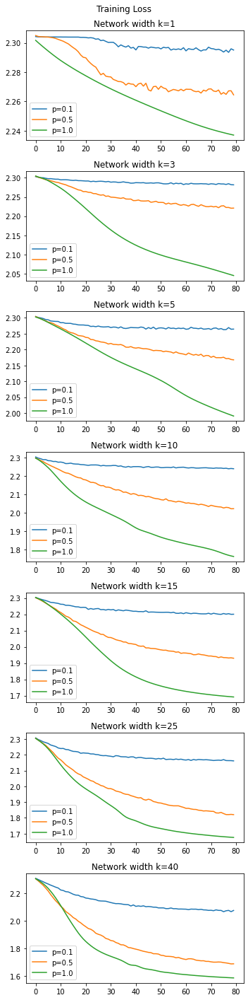

In [467]:
#Training loss vs epochs plot
fig, axs = plt.subplots(len(k))
fig.set_size_inches(5,20)
fig.suptitle('Training Loss\n')
for i in range(len(k)):
    axs[i].plot(range(80),train_loss[3*i+0],label='p=0.1')
    axs[i].plot(range(80),train_loss[3*i+1],label='p=0.5')
    axs[i].plot(range(80),train_loss[3*i+2],label='p=1.0')
    axs[i].set_title("Network width k={}".format(k[i]))
    axs[i].legend()
fig.tight_layout()

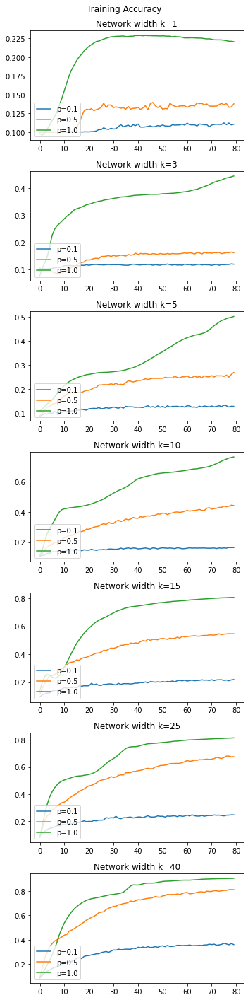

In [494]:
#Training accuracy vs epochs plot
fig, axs = plt.subplots(len(k))
fig.set_size_inches(5,20)
fig.suptitle('Training Accuracy\n')
for i in range(len(k)):
    axs[i].plot(range(80),train_acc[3*i+0],label='p=0.1')
    axs[i].plot(range(80),train_acc[3*i+1],label='p=0.5')
    axs[i].plot(range(80),train_acc[3*i+2],label='p=1.0')
    axs[i].set_title("Network width k={}".format(k[i]))
    axs[i].legend(loc=3)
fig.tight_layout()

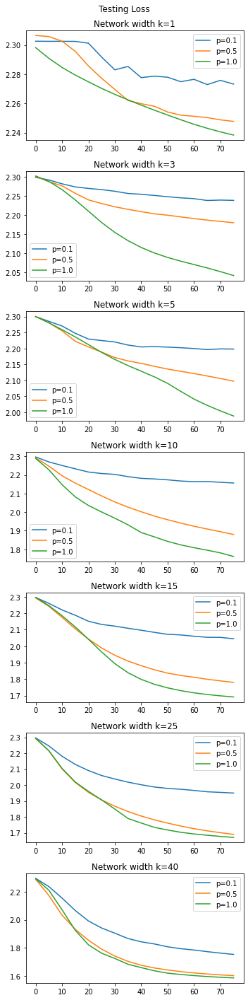

In [469]:
#Testing loss vs epochs plot
fig, axs = plt.subplots(len(k))
epoch=[0,5,10,15,20,25,30,35,40,45,50,55,60,65,70,75]
fig.set_size_inches(5,20)
fig.suptitle('Testing Loss\n')
for i in range(len(k)):
    axs[i].plot(epoch,test_loss[3*i+0],label='p=0.1')
    axs[i].plot(epoch,test_loss[3*i+1],label='p=0.5')
    axs[i].plot(epoch,test_loss[3*i+2],label='p=1.0')
    axs[i].set_title("Network width k={}".format(k[i]))
    axs[i].legend()
fig.tight_layout()

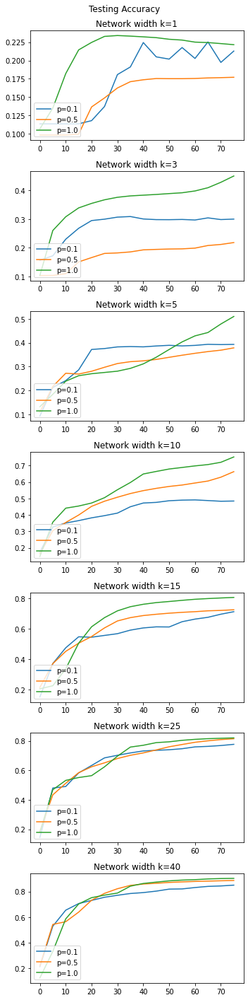

In [495]:
#Testing accuracy vs epochs plot
fig, axs = plt.subplots(len(k))
epoch=[0,5,10,15,20,25,30,35,40,45,50,55,60,65,70,75]
fig.set_size_inches(5,20)
fig.suptitle('Testing Accuracy\n')
for i in range(len(k)):
    axs[i].plot(epoch,acc[3*i+0],label='p=0.1')
    axs[i].plot(epoch,acc[3*i+1],label='p=0.5')
    axs[i].plot(epoch,acc[3*i+2],label='p=1.0')
    axs[i].set_title("Network width k={}".format(k[i]))
    axs[i].legend(loc=3)
fig.tight_layout()

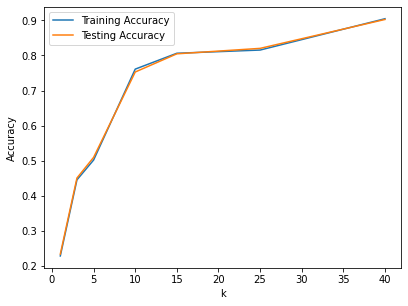

In [477]:
#plot for training accuracy and testing accuracy vs k
temp, temp1=[],[]
for i in range(len(k)):
    temp.append(max(train_acc[3*i+2]))
    temp1.append(max(acc[3*i+2]))
plt.plot(k,temp,label='Training Accuracy')
plt.plot(k,temp1,label='Testing Accuracy')
plt.xlabel("k")
plt.ylabel("Accuracy")
plt.legend()

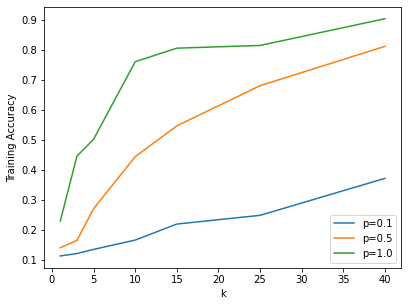

In [499]:
#plot for training accuracy as a function of k for different p
temp, temp1, temp2=[],[], []

for i in range(len(k)):
    temp.append(max(train_acc[3*i+0]))
    temp1.append(max(train_acc[3*i+1]))
    temp2.append(max(train_acc[3*i+2]))
plt.plot(k,temp,label='p=0.1')
plt.plot(k,temp1,label='p=0.5')
plt.plot(k,temp2,label='p=1.0')
plt.xlabel("k")
plt.ylabel("Training Accuracy")
plt.legend(loc=4)

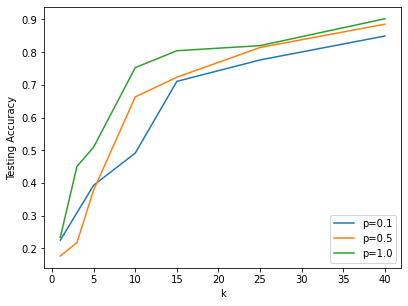

In [500]:
#plot for testing accuracy as a function of k for different p
temp, temp1, temp2=[],[], []

for i in range(len(k)):
    temp.append(max(acc[3*i+0]))
    temp1.append(max(acc[3*i+1]))
    temp2.append(max(acc[3*i+2]))
plt.plot(k,temp,label='p=0.1')
plt.plot(k,temp1,label='p=0.5')
plt.plot(k,temp2,label='p=1.0')
plt.xlabel("k")
plt.ylabel("Testing Accuracy")
plt.legend(loc=4)

## Adding noise to the training data

In [478]:
Y_trainmod=Y_train.detach().clone()

In [479]:
temp=random.sample(range(len(Y_train)),4000)

In [480]:
for i in temp:
    lst=list(range(0,10))
    #print(lst)
    ch=Y_train[i]
    #print(ch)
    lst.remove(ch)
    #print(lst)
    Y_trainmod[i]=random.choice(lst)

In [487]:
#function to train model with noisy data
def noisytrain():
    epochs=80

    total_acc, testloss, trainloss, train_acc= [], [] , [], []

    for i in range(epochs):

        model.train()

        y_pred=model(X_train.float())
        #print(y_pred)
        loss= loss_fn(y_pred,Y_trainmod)
        trainloss.append(loss.item())
        total=0
        for j in range(len(Y_trainmod)):
            if(int(Y_trainmod[j])== int(torch.argmax(y_pred[j]))):
                total+=1
        trainacc=total/len(Y_trainmod)
        train_acc.append(trainacc)
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        model.eval()
        y_pred_test=model(X_test.float())
        test_loss= loss_fn(y_pred_test,Y_test)
        testloss.append(test_loss.item())

        total=0
        for j in range(len(Y_test)):
            if(int(Y_test[j])== int(torch.argmax(y_pred_test[j]))):
                total+=1
        acc=total/len(Y_test)
        total_acc.append(acc)

        if i%5==0:
            print("Epoch [{}/{}], Train loss: {:.5f}, Testloss: {:.5f}, Accuracy: {:.5f}, Training acc: {:.5f}".format(i,epochs,loss.item(),test_loss.item(),acc,trainacc))
    print("\nTraining complete")
    return total_acc,testloss,trainloss,train_acc

In [484]:
#Testing for different network width and dufferent values of p
k=[1,3,5,10,15,25,40]
p=[0.1,0.5,1.0]
ntrain_loss, ntest_loss, nacc, ntrain_acc=[], [], [], []
for i in k:
    for j in p:
        model=Network(j,i)
        model.to(device)
        print(model)
        loss_fn=nn.CrossEntropyLoss()
        device="cpu"
        optimizer=torch.optim.Adam(model.parameters(),lr=0.001)
        accuracy, testloss, trainloss, trainacc= noisytrain()
        ntrain_loss.append(trainloss)
        ntest_loss.append(testloss)
        nacc.append(accuracy)
        ntrain_acc.append(trainacc)

Network(
  (hidden): Linear(in_features=784, out_features=1, bias=True)
  (dropout): Dropout(p=0.9, inplace=False)
  (output): Linear(in_features=1, out_features=10, bias=True)
  (softmax): Softmax(dim=1)
  (relu): ReLU()
)
Epoch [0/80], Train loss: 2.30361, Testloss: 2.30006, Accuracy: 0.10540, Training acc: 0.10150
Epoch [5/80], Train loss: 2.30111, Testloss: 2.29687, Accuracy: 0.12140, Training acc: 0.10460
Epoch [10/80], Train loss: 2.30107, Testloss: 2.29229, Accuracy: 0.16050, Training acc: 0.10470
Epoch [15/80], Train loss: 2.30044, Testloss: 2.29124, Accuracy: 0.16000, Training acc: 0.10430
Epoch [20/80], Train loss: 2.29848, Testloss: 2.28871, Accuracy: 0.16930, Training acc: 0.10710
Epoch [25/80], Train loss: 2.29937, Testloss: 2.28523, Accuracy: 0.17950, Training acc: 0.10600
Epoch [30/80], Train loss: 2.29982, Testloss: 2.28420, Accuracy: 0.18050, Training acc: 0.10530
Epoch [35/80], Train loss: 2.30104, Testloss: 2.28496, Accuracy: 0.17790, Training acc: 0.10420
Epoch [40/

Epoch [45/80], Train loss: 2.25872, Testloss: 2.18375, Accuracy: 0.35000, Training acc: 0.17320
Epoch [50/80], Train loss: 2.26005, Testloss: 2.17807, Accuracy: 0.35160, Training acc: 0.17070
Epoch [55/80], Train loss: 2.25704, Testloss: 2.17262, Accuracy: 0.35400, Training acc: 0.17350
Epoch [60/80], Train loss: 2.25766, Testloss: 2.16796, Accuracy: 0.35500, Training acc: 0.16830
Epoch [65/80], Train loss: 2.25620, Testloss: 2.16424, Accuracy: 0.35770, Training acc: 0.17370
Epoch [70/80], Train loss: 2.25333, Testloss: 2.16005, Accuracy: 0.35850, Training acc: 0.17650
Epoch [75/80], Train loss: 2.25113, Testloss: 2.15672, Accuracy: 0.36140, Training acc: 0.17680

Training complete
Network(
  (hidden): Linear(in_features=784, out_features=3, bias=True)
  (dropout): Dropout(p=0.0, inplace=False)
  (output): Linear(in_features=3, out_features=10, bias=True)
  (softmax): Softmax(dim=1)
  (relu): ReLU()
)
Epoch [0/80], Train loss: 2.30490, Testloss: 2.30264, Accuracy: 0.11720, Training acc

Epoch [10/80], Train loss: 2.28811, Testloss: 2.25398, Accuracy: 0.31880, Training acc: 0.11860
Epoch [15/80], Train loss: 2.28558, Testloss: 2.24093, Accuracy: 0.38620, Training acc: 0.12090
Epoch [20/80], Train loss: 2.28227, Testloss: 2.22922, Accuracy: 0.44810, Training acc: 0.12570
Epoch [25/80], Train loss: 2.27882, Testloss: 2.21418, Accuracy: 0.46430, Training acc: 0.12810
Epoch [30/80], Train loss: 2.28163, Testloss: 2.20982, Accuracy: 0.48080, Training acc: 0.12570
Epoch [35/80], Train loss: 2.27843, Testloss: 2.20319, Accuracy: 0.49450, Training acc: 0.12750
Epoch [40/80], Train loss: 2.27713, Testloss: 2.19754, Accuracy: 0.49010, Training acc: 0.12680
Epoch [45/80], Train loss: 2.27564, Testloss: 2.19129, Accuracy: 0.49470, Training acc: 0.13160
Epoch [50/80], Train loss: 2.27460, Testloss: 2.18930, Accuracy: 0.50310, Training acc: 0.13040
Epoch [55/80], Train loss: 2.27558, Testloss: 2.18676, Accuracy: 0.50470, Training acc: 0.13500
Epoch [60/80], Train loss: 2.27513, Test

Epoch [70/80], Train loss: 2.11871, Testloss: 1.78726, Accuracy: 0.77300, Training acc: 0.33790
Epoch [75/80], Train loss: 2.10988, Testloss: 1.77534, Accuracy: 0.78710, Training acc: 0.35130

Training complete
Network(
  (hidden): Linear(in_features=784, out_features=15, bias=True)
  (dropout): Dropout(p=0.0, inplace=False)
  (output): Linear(in_features=15, out_features=10, bias=True)
  (softmax): Softmax(dim=1)
  (relu): ReLU()
)
Epoch [0/80], Train loss: 2.30392, Testloss: 2.29470, Accuracy: 0.17940, Training acc: 0.08920
Epoch [5/80], Train loss: 2.27050, Testloss: 2.22040, Accuracy: 0.40510, Training acc: 0.25920
Epoch [10/80], Train loss: 2.22415, Testloss: 2.12723, Accuracy: 0.44690, Training acc: 0.27170
Epoch [15/80], Train loss: 2.17956, Testloss: 2.04407, Accuracy: 0.52410, Training acc: 0.32070
Epoch [20/80], Train loss: 2.14367, Testloss: 1.97453, Accuracy: 0.58580, Training acc: 0.35070
Epoch [25/80], Train loss: 2.11180, Testloss: 1.91387, Accuracy: 0.66150, Training ac

Epoch [35/80], Train loss: 2.20882, Testloss: 1.90404, Accuracy: 0.70530, Training acc: 0.22070
Epoch [40/80], Train loss: 2.20537, Testloss: 1.88248, Accuracy: 0.71120, Training acc: 0.22520
Epoch [45/80], Train loss: 2.19959, Testloss: 1.86690, Accuracy: 0.71880, Training acc: 0.22740
Epoch [50/80], Train loss: 2.19932, Testloss: 1.85869, Accuracy: 0.72500, Training acc: 0.22950
Epoch [55/80], Train loss: 2.19527, Testloss: 1.84745, Accuracy: 0.73170, Training acc: 0.22860
Epoch [60/80], Train loss: 2.19185, Testloss: 1.84105, Accuracy: 0.73930, Training acc: 0.23770
Epoch [65/80], Train loss: 2.19261, Testloss: 1.83073, Accuracy: 0.74450, Training acc: 0.23450
Epoch [70/80], Train loss: 2.19303, Testloss: 1.82292, Accuracy: 0.75010, Training acc: 0.23270
Epoch [75/80], Train loss: 2.19145, Testloss: 1.81889, Accuracy: 0.75850, Training acc: 0.23580

Training complete
Network(
  (hidden): Linear(in_features=784, out_features=40, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
 

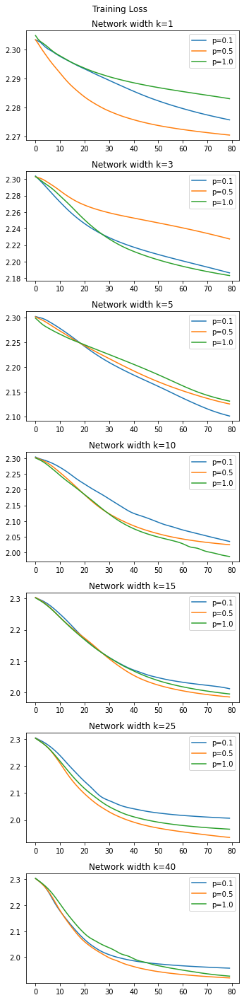

In [316]:
#Training loss vs epochs plot
fig, axs = plt.subplots(len(k))
fig.set_size_inches(5,20)
fig.suptitle('Training Loss\n')
for i in range(len(k)):
    axs[i].plot(range(80),ntrain_loss[3*i+0],label='p=0.1')
    axs[i].plot(range(80),ntrain_loss[3*i+1],label='p=0.5')
    axs[i].plot(range(80),ntrain_loss[3*i+2],label='p=1.0')
    axs[i].set_title("Network width k={}".format(k[i]))
    axs[i].legend()
fig.tight_layout()

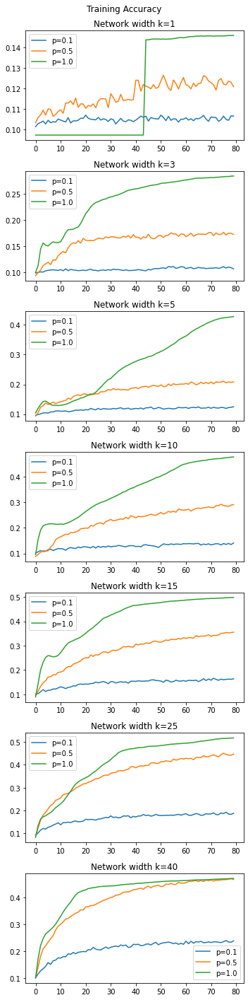

In [489]:
#Training accuracy vs epochs plot
fig, axs = plt.subplots(len(k))
fig.set_size_inches(5,20)
fig.suptitle('Training Accuracy\n')
for i in range(len(k)):
    axs[i].plot(range(80),ntrain_acc[3*i+0],label='p=0.1')
    axs[i].plot(range(80),ntrain_acc[3*i+1],label='p=0.5')
    axs[i].plot(range(80),ntrain_acc[3*i+2],label='p=1.0')
    axs[i].set_title("Network width k={}".format(k[i]))
    axs[i].legend()
fig.tight_layout()

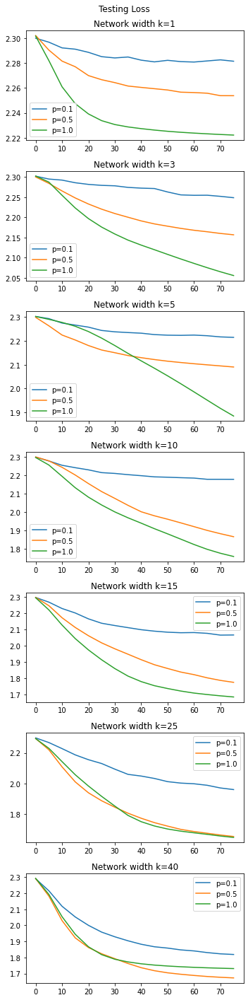

In [490]:
#Testing loss vs epochs plot
fig, axs = plt.subplots(len(k))
epoch=[0,5,10,15,20,25,30,35,40,45,50,55,60,65,70,75]
fig.set_size_inches(5,20)
fig.suptitle('Testing Loss\n')
for i in range(len(k)):
    axs[i].plot(epoch,ntest_loss[3*i+0],label='p=0.1')
    axs[i].plot(epoch,ntest_loss[3*i+1],label='p=0.5')
    axs[i].plot(epoch,ntest_loss[3*i+2],label='p=1.0')
    axs[i].set_title("Network width k={}".format(k[i]))
    axs[i].legend()
fig.tight_layout()

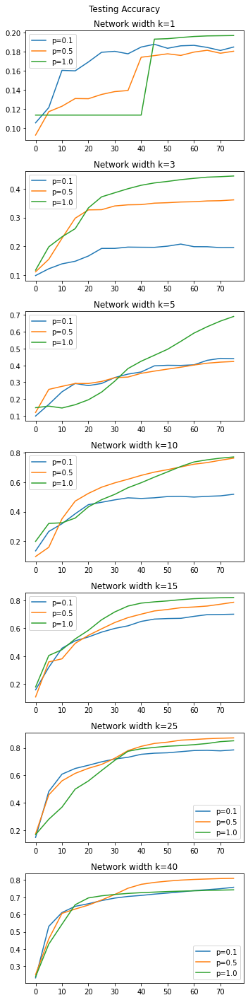

In [491]:
#Testing accuracy vs epochs plot
fig, axs = plt.subplots(len(k))
epoch=[0,5,10,15,20,25,30,35,40,45,50,55,60,65,70,75]
fig.set_size_inches(5,20)
fig.suptitle('Testing Accuracy\n')
for i in range(len(k)):
    axs[i].plot(epoch,nacc[3*i+0],label='p=0.1')
    axs[i].plot(epoch,nacc[3*i+1],label='p=0.5')
    axs[i].plot(epoch,nacc[3*i+2],label='p=1.0')
    axs[i].set_title("Network width k={}".format(k[i]))
    axs[i].legend()
fig.tight_layout()

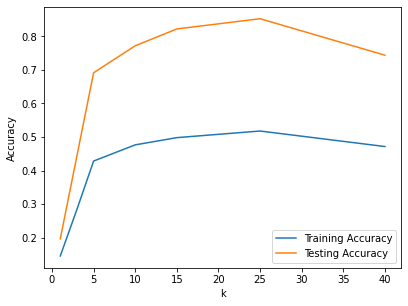

In [504]:
#plot for training accuracy and testing accuracy vs k
temp, temp1=[],[]
for i in range(len(k)):
    temp.append(max(ntrain_acc[3*i+2]))
    temp1.append(max(nacc[3*i+2]))
plt.plot(k,temp,label='Training Accuracy')
plt.plot(k,temp1,label='Testing Accuracy')
plt.xlabel("k")
plt.ylabel("Accuracy")
plt.legend()

In [506]:
max(temp1)

0.8522

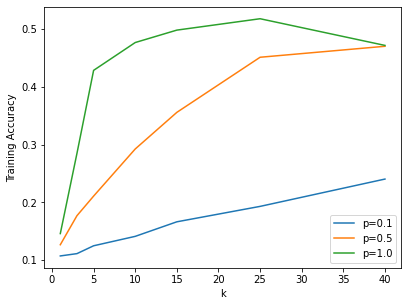

In [502]:
#plot for training accuracy as a function of k for different p
temp, temp1, temp2=[],[], []

for i in range(len(k)):
    temp.append(max(ntrain_acc[3*i+0]))
    temp1.append(max(ntrain_acc[3*i+1]))
    temp2.append(max(ntrain_acc[3*i+2]))
plt.plot(k,temp,label='p=0.1')
plt.plot(k,temp1,label='p=0.5')
plt.plot(k,temp2,label='p=1.0')
plt.xlabel("k")
plt.ylabel("Training Accuracy")
plt.legend(loc=4)

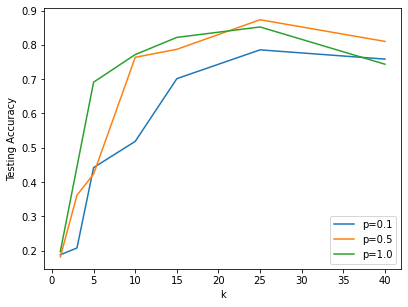

In [503]:
#plot for testing accuracy as a function of k for different p
temp, temp1, temp2=[],[], []

for i in range(len(k)):
    temp.append(max(nacc[3*i+0]))
    temp1.append(max(nacc[3*i+1]))
    temp2.append(max(nacc[3*i+2]))
plt.plot(k,temp,label='p=0.1')
plt.plot(k,temp1,label='p=0.5')
plt.plot(k,temp2,label='p=1.0')
plt.xlabel("k")
plt.ylabel("Testing Accuracy")
plt.legend(loc=4)